<a href="https://colab.research.google.com/github/wing787/books-python-satellite-data-analysis-basic/blob/main/5_ch4_2_ForestAnalysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 4-2 森林分野における衛星データ利用事例
## この章で学ぶこと

本章では、茨城県日立市を対象に、衛星データからNDVIを算出し森林の状態変化を可視化する方法を学ぶ
* numpyを用いた画像解析処理演算
* rasterioを用いたカラー合成画像の作成とマスク処理
* rasterioを用いたNDVIの計算
* matplotlibを用いたグラフ作成

Google Colabのアップデートによって追加された初期ライブラリ
（2023-10-16時点）
* pyproj
* fiona
* shapely
* geopandas
*

In [ ]:
# !pip install pygeos
# !pip install rasterio
# !pip install sentinelsat
# !pip install cartopy
# !pip install rtree
# !pip install sat-search
# # !pip install python-dateutil
# !pip install pystac-client
# # !pip install intake-stac
# # !pip install git+https://github.com/intake/intake-stac

In [ ]:
# # Google Colabを使っている場合には、ドライブのマウントを行います
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
import os
os.environ['USE_PYGEOS'] = '0'
import numpy as np
import geopandas as gpd
import pandas as pd
import matplotlib
import cartopy, fiona, shapely, pyproj, rtree, pygeos
import cv2
matplotlib.rcParams['figure.dpi'] = 300  # 解像度
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import rasterio as rio
import rasterio.mask
import folium
import zipfile
import glob
import shutil
# from sentinelsat import SentinelAPI, read_geojson, geojson_to_wkt
# from PIL import Image
from IPython.display import Image
from mpl_toolkits.axes_grid1 import make_axes_locatable
from shapely.geometry import MultiPolygon, Polygon
from rasterio import plot
from rasterio.plot import show
from rasterio.plot import plotting_extent
from rasterio.mask import mask
from osgeo import gdal

import warnings
warnings.filterwarnings('ignore')

print("done")

done


書籍より

> この章では、地理空間情報を有した画像形式であるGeoTIFFを初めとしたラスター形式の画像ファイルを利用するためのライブラリである`rasterio`を中心にして解説をしていきます。  
`osgeo.gdal`を利用する場合とコードに差はありますが、処理に必要な知識については変わるところはありません。rasterioは、gdalで出来るラスター画像の処理をほとんど代替できると考えて良いです。恐れずに言ってしまえば、rasterioはPython版のラスター解析用gdalということになります。加えて、そのコードはgdalに比べてすっきりとし、可読性も高くなります。

## 4-2-1 森林の状態変化の視覚化

### 衛星画像取得

画像データは直接取得

In [ ]:
#

file_path = glob.glob('/content/drive/MyDrive/Colab Notebooks/Pythonで学ぶ衛星データ解析基礎-環境変化を定量的に把握しよう/data/4/s2/*.zip')

ziplst = []

for f in file_path:
  print(f[86:146])
  ziplst.append(f[86:146])

for file_title in ziplst:
  print('--------------------------------')
  print('start unzip:', file_title)
  file_name = file_title + '.SAFE.zip'
  file_dir = '/content/drive/MyDrive/Colab Notebooks/Pythonで学ぶ衛星データ解析基礎-環境変化を定量的に把握しよう/data/4/s2/'
  file_pass = os.path.join(file_dir + file_name)
  print(file_pass)
  print('file unzip')
  with zipfile.ZipFile(file_pass) as zf:
    zf.extractall()

  print('unzip done')

print('All file unzip done')

S2A_MSIL1C_20170508T012701_N0205_R074_T54SVF_20170508T013110
S2A_MSIL1C_20181219T013041_N0207_R074_T54SVF_20181219T031650
S2B_MSIL1C_20181002T011649_N0206_R031_T54SVF_20181002T030308
S2B_MSIL1C_20171027T011719_N0206_R031_T54SVF_20171027T030539
S2B_MSIL1C_20171226T012039_N0206_R031_T54SVF_20171226T024938
S2A_MSIL1C_20180420T011651_N0206_R031_T54SVF_20180420T030851
S2A_MSIL1C_20180520T011701_N0206_R031_T54SVF_20180520T030828
--------------------------------
start unzip: S2A_MSIL1C_20170508T012701_N0205_R074_T54SVF_20170508T013110
/content/drive/MyDrive/Colab Notebooks/Pythonで学ぶ衛星データ解析基礎-環境変化を定量的に把握しよう/data/4/s2/S2A_MSIL1C_20170508T012701_N0205_R074_T54SVF_20170508T013110.SAFE.zip
file unzip
unzip done
--------------------------------
start unzip: S2A_MSIL1C_20181219T013041_N0207_R074_T54SVF_20181219T031650
/content/drive/MyDrive/Colab Notebooks/Pythonで学ぶ衛星データ解析基礎-環境変化を定量的に把握しよう/data/4/s2/S2A_MSIL1C_20181219T013041_N0207_R074_T54SVF_20181219T031650.SAFE.zip
file unzip
unzip done
---

↓ファイル確認用

In [ ]:
conf_filepath = glob.glob('/content/*.SAFE')
print(os.listdir(conf_filepath[0]))

# バンド数の確認
print('The number of bands' , len(os.listdir('/content/S2A_MSIL1C_20170508T012701_N0205_R074_T54SVF_20170508T013110.SAFE/GRANULE/L1C_T54SVF_A009795_20170508T013110/IMG_DATA')))

['rep_info', 'INSPIRE.xml', 'DATASTRIP', 'S2A_MSIL1C_20180420T011651_N0206_R031_T54SVF_20180420T030851-ql.jpg', 'MTD_MSIL1C.xml', 'AUX_DATA', 'manifest.safe', 'GRANULE', 'HTML']
The number of bands 14


In [ ]:
# make work dir

os.mkdir('work')

PATH = '/content/'
WORK_PATH = '/content/work'

RGB_DIR = '/content/RGB_TIF'
os.mkdir(RGB_DIR)

NDVI_DIR = '/content/NDVI'
os.mkdir(NDVI_DIR)

NDVI_mask_DIR = '/content/NDVI_mask'
os.mkdir(NDVI_mask_DIR)

### 日立市のポリゴン取得

続けて日立市のポリゴンデータ(shpファイル）を取得する。このファイルは、大きな衛星画像を日立市のみで切り取るために利用する。

国土地理院が公開している国土数値情報のうち[行政区域データ](https://nlftp.mlit.go.jp/ksj/gml/datalist/KsjTmplt-N03-v2_3.html)から[ダウンロード](https://nlftp.mlit.go.jp/ksj/gml/data/N03/N03-2019/N03-190101_08_GML.zip)する。ダウンロードは県単位になるため、茨城県から日立市のポリゴンを以下のように抜き出す（平成31年のデータを利用している）。

抜き出したら、ポリゴンの座標系をSentinel-2のデータと同じUTM zone 54N (EPSG:32654) に変換。

In [ ]:
# 行政区域データをダウンロードするフォルダの作成
os.makedirs('ibarakiPolygon', exist_ok=True)

# use wget
!wget --restrict-file-names=nocontrol \
     --content-disposition \
     --user-agent="Mozilla/5.0 (Windows NT 10.0; Win64; x64; rv:52.0) Gecko/20100101 Firefox/52.0" \
     "https://nlftp.mlit.go.jp/ksj/gml/data/N03/N03-2019/N03-190101_08_GML.zip" \
     -P /content/ibarakiPolygon

import zipfile

# ダウンロードしたファイルを展開
with zipfile.ZipFile('/content/ibarakiPolygon/N03-190101_08_GML.zip') as zipf:
  for zinfo in zipf.infolist():        # ZipInfoオブジェクトを取得
      if not zinfo.flag_bits & 0x800:  # flag_bitsプロパティで文字コードを取得
          # 文字コードが(cp437)だった場合はcp932へ変換する
          # strオブジェクトのプロパティencode/decodeでcp932に変換
          # 変換後のファイル名をfilenameプロパティで再度し直す
          zinfo.filename = zinfo.filename.encode('cp437').decode('cp932')
          if os.sep != "/" and os.sep in zinfo.filename:
            zinfo.filename = zinfo.filename.replace(os.sep, "/")

      zipf.extract(zinfo, '/content/ibarakiPolygon')

--2023-10-18 23:34:22--  https://nlftp.mlit.go.jp/ksj/gml/data/N03/N03-2019/N03-190101_08_GML.zip
Resolving nlftp.mlit.go.jp (nlftp.mlit.go.jp)... 147.154.8.35, 147.154.3.128, 147.154.1.1
Connecting to nlftp.mlit.go.jp (nlftp.mlit.go.jp)|147.154.8.35|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3716112 (3.5M) [application/zip]
Saving to: ‘/content/ibarakiPolygon/N03-190101_08_GML.zip’

N03-190101_08_GML.z 100%[===================>]   3.54M  4.80MB/s    in 0.7s    

2023-10-18 23:34:24 (4.80 MB/s) - ‘/content/ibarakiPolygon/N03-190101_08_GML.zip’ saved [3716112/3716112]



done


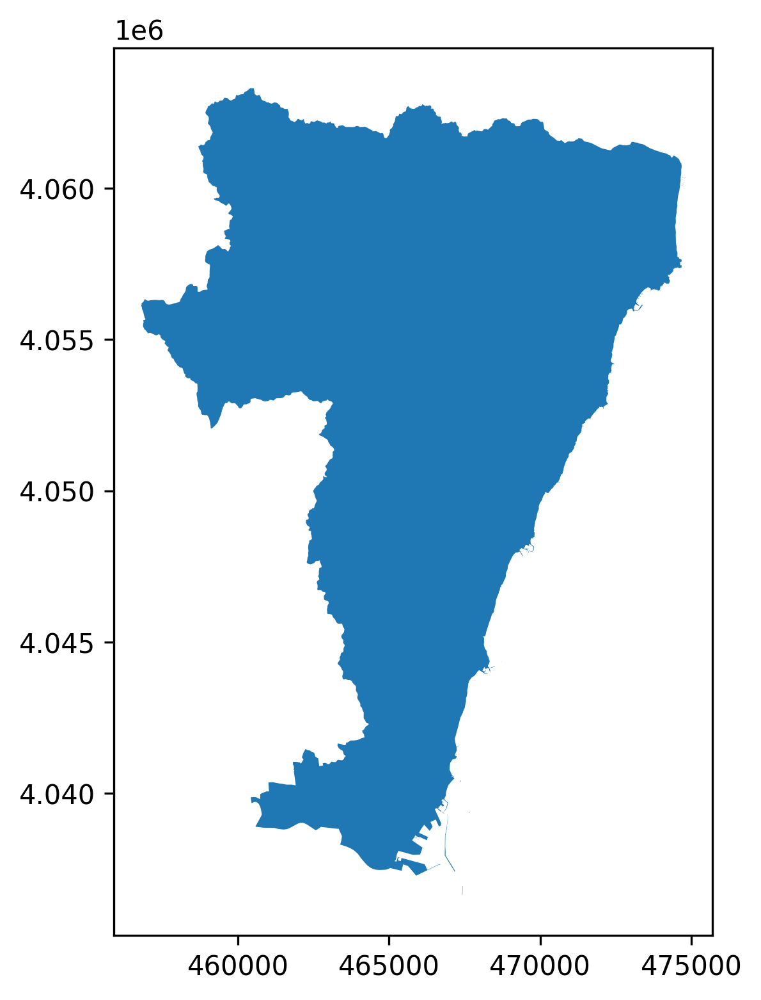

In [ ]:
shape_path = "/content/ibarakiPolygon/"

# 茨城県のshpの読み込み
in_shape = gpd.read_file(os.path.join(shape_path + "N03-19_08_190101.shp"),encoding="shift-jis")

# 日立市でソート
shape_srt = in_shape[in_shape["N03_004"].isin(["日立市"])]
shape_srt = shape_srt.drop(columns=["N03_002","N03_003"])

#画像に合わせて投影変換
out_file = os.path.join(shape_path + "re_N03-19_08_190101.shp")
re_shape = shape_srt.to_crs({"init": "epsg:32654"})

#出力
re_shape.to_file(driver="ESRI Shapefile",filename=out_file,encoding='utf-8')
print("done")

#GeoDataFrameを描画
f,ax = plt.subplots(1, figsize=(6,6))
ax = re_shape.plot(axes=ax)
plt.show();

### カラー合成とマスク処理
Sentinel-2は異なる12の波長帯（バンド）で観測しているが、ダウンロードしたデータはバンド毎にjpeg2の形式で格納されている。
まずは、基礎分野で学習した「トゥルーカラー（True Color）」の組み合わせでカラー合成し、日立市以外の領域をマスクしてみる。
ここではrasterioで、バンド2（青）・バンド3（緑）・バンド4（赤）を組み合わせて合成し、ポリゴンデータを使って日立市以外をマスクする。

In [ ]:
for file_title in ziplst:
  print("Start make RGB TIF image " +'<'+ file_title +'>')

  path_A = str(file_title) + '.SAFE/GRANULE/'
  f1 = os.listdir(path_A)
  path_B = str(file_title) + '.SAFE/GRANULE/' + str(f1[0])
  f2 = os.listdir(path_B)
  path_C = str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) + '/IMG_DATA/'
  f3 = os.listdir(path_C)

  b2 = rio.open(str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) +'/IMG_DATA/' +str(f3[0][0:23] +'B02.jp2'))
  b3 = rio.open(str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) +'/IMG_DATA/' +str(f3[0][0:23] +'B03.jp2'))
  b4 = rio.open(str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) +'/IMG_DATA/' +str(f3[0][0:23] +'B04.jp2'))

  RGB_path = os.path.join(RGB_DIR,'sentinel-2_'+str(f3[0][7:15])+'_RGB.tif')


  RGB_colar = rio.open(RGB_path,'w',driver='Gtiff',
                       width=b4.width, height=b4.height,
                       count=3,
                       crs=b4.crs,
                       transform=b4.transform,
                       dtype=rio.uint16
                       )
  RGB_colar.write(b2.read(1),3)
  RGB_colar.write(b3.read(1),2)
  RGB_colar.write(b4.read(1),1)
  RGB_colar.close()

  print("---masking---")

  with fiona.open(out_file, "r") as mask:
    masks = [feature["geometry"] for feature in mask]

  with rio.open(RGB_path) as src:
    out_image, out_transform = rasterio.mask.mask(src, masks, crop=True)
    out_meta = src.meta

  out_meta.update({"driver": "GTiff",
                 "height": out_image.shape[1],
                 "width": out_image.shape[2],
                 "transform": out_transform})

  with rio.open(RGB_path, "w", **out_meta) as dest:
    dest.write(out_image)

  #画像表示のため8bit形式で書き出し。
  scale = '-scale 0 255 0 15'
  options_list = ['-ot Byte','-of Gtiff',scale]
  options_string = " ".join(options_list)

  gdal.Translate(os.path.join(RGB_DIR + "/" + 'sentinel-2_'+str(f3[0][7:15])+'.tif'),os.path.join(RGB_DIR + "/" + 'sentinel-2_'+str(f3[0][7:15])+'_RGB.tif'),options = options_string)

  print("Done")

Start make RGB TIF image <S2A_MSIL1C_20170508T012701_N0205_R074_T54SVF_20170508T013110>
---masking---
Done
Start make RGB TIF image <S2A_MSIL1C_20181219T013041_N0207_R074_T54SVF_20181219T031650>
---masking---
Done
Start make RGB TIF image <S2B_MSIL1C_20181002T011649_N0206_R031_T54SVF_20181002T030308>
---masking---
Done
Start make RGB TIF image <S2B_MSIL1C_20171027T011719_N0206_R031_T54SVF_20171027T030539>
---masking---
Done
Start make RGB TIF image <S2B_MSIL1C_20171226T012039_N0206_R031_T54SVF_20171226T024938>
---masking---
Done
Start make RGB TIF image <S2A_MSIL1C_20180420T011651_N0206_R031_T54SVF_20180420T030851>
---masking---
Done
Start make RGB TIF image <S2A_MSIL1C_20180520T011701_N0206_R031_T54SVF_20180520T030828>
---masking---
Done


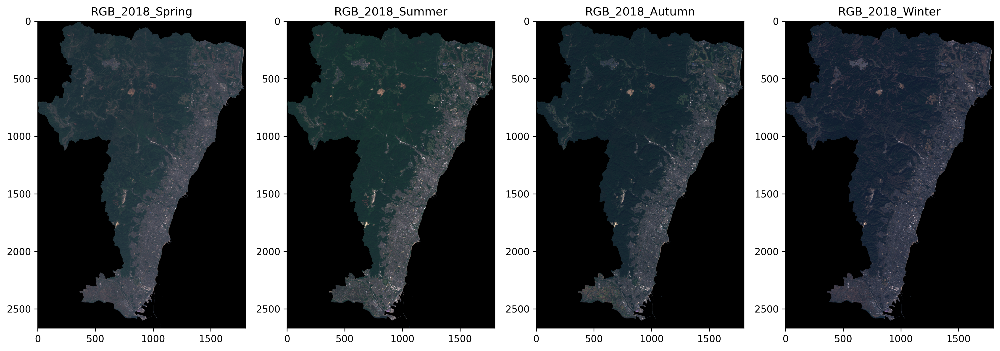

In [ ]:
plt.figure(figsize=(18, 9))

RGB_2018_spring = rio.open(RGB_DIR + '/sentinel-2_20180420.tif')
RGB_2018_summer = rio.open(RGB_DIR + '/sentinel-2_20180520.tif')
RGB_2018_autumn = rio.open(RGB_DIR + '/sentinel-2_20181002.tif')
RGB_2018_winter = rio.open(RGB_DIR + '/sentinel-2_20181219.tif')

ax1 = plt.subplot(1, 4, 1)
ax1.set_title('RGB_2018_Spring')
ax2 = plt.subplot(1, 4, 2)
ax2.set_title('RGB_2018_Summer')
ax3 = plt.subplot(1, 4, 3)
ax3.set_title('RGB_2018_Autumn')
ax4 = plt.subplot(1, 4, 4)
ax4.set_title('RGB_2018_Winter')

show(RGB_2018_spring.read([1, 2, 3]), ax=ax1);
show(RGB_2018_summer.read([1, 2, 3]), ax=ax2);
show(RGB_2018_autumn.read([1, 2, 3]), ax=ax3);
show(RGB_2018_winter.read([1, 2, 3]), ax=ax4);

## 4-2-2 森林の状態変化の可視化
### 森林地域のポリゴン取得
国土数値情報には、土地利用基本計画に基づき指定された森林地域のポリゴンも含まれる。
このサイトから茨城県の森林地域のポリゴンをダウンロードし、日立市のポリゴンと同様に座標系をUTM zone54N(EPSG: 32654)に変換する

--2023-10-18 23:40:14--  https://nlftp.mlit.go.jp/ksj/gml/data/A13/A13-15/A13-15_08_GML.zip
Resolving nlftp.mlit.go.jp (nlftp.mlit.go.jp)... 192.29.105.247, 147.154.112.73, 147.154.116.181
Connecting to nlftp.mlit.go.jp (nlftp.mlit.go.jp)|192.29.105.247|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 147403575 (141M) [application/zip]
Saving to: ‘/content/forestPolygon/A13-15_08_GML.zip’

A13-15_08_GML.zip   100%[===================>] 140.57M  30.6MB/s    in 5.1s    

2023-10-18 23:40:20 (27.6 MB/s) - ‘/content/forestPolygon/A13-15_08_GML.zip’ saved [147403575/147403575]

done


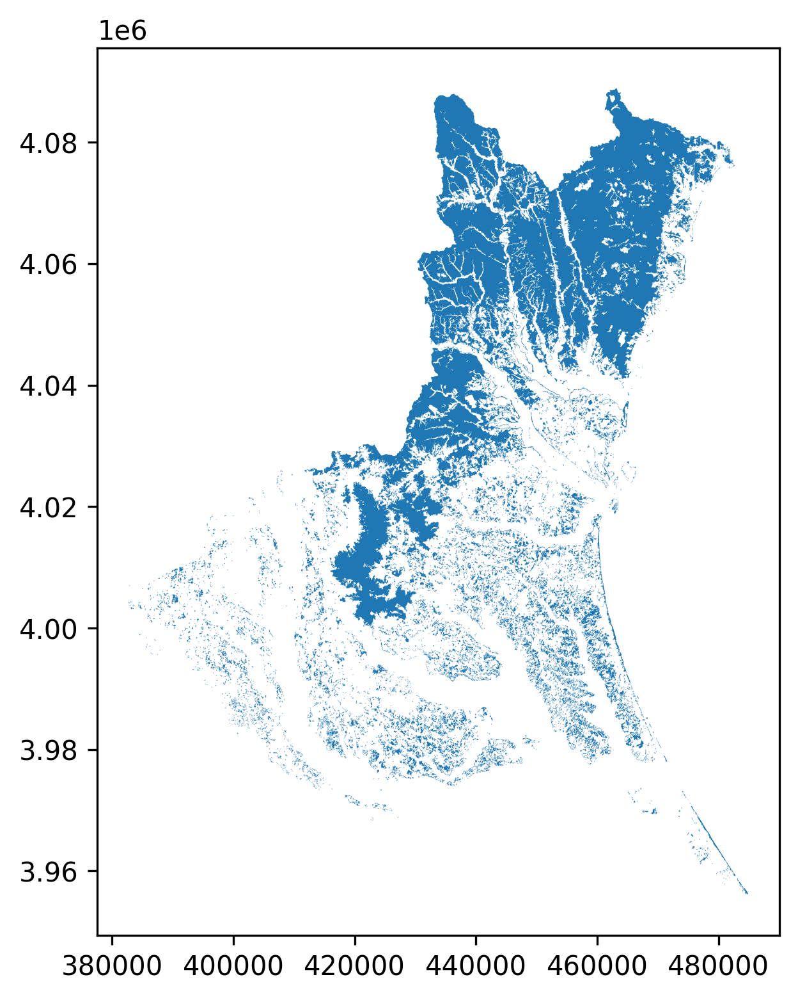

In [ ]:
# 森林マップポリゴンをダウンロードするフォルダの作成
FOREST_DIR = 'forestPolygon'
os.makedirs(FOREST_DIR, exist_ok=True)
# wgetを行う
!wget --restrict-file-names=nocontrol \
     --content-disposition \
     --user-agent="Mozilla/5.0 (Windows NT 10.0; Win64; x64; rv:52.0) Gecko/20100101 Firefox/52.0" \
     "https://nlftp.mlit.go.jp/ksj/gml/data/A13/A13-15/A13-15_08_GML.zip" \
     -P /content/forestPolygon
# ダウンロードしたファイルを展開する
with zipfile.ZipFile('/content/forestPolygon/A13-15_08_GML.zip') as zipf:
  for zinfo in zipf.infolist():
    # ZipInfoオブジェクトを取得
    if not zinfo.flag_bits & 0x800:
      # flag_bitsプロパティで文字コードを取得
      # 文字コードが(cp437)だった場合はcp932へ変換する
      # strオブジェクトのプロパティencode/decodeでcp932に変換
      # 変換後のファイル名をfilenameプロパティで再度し直す
      zinfo.filename = zinfo.filename.encode('cp437').decode('cp932')
      if os.sep != "/" and os.sep in zinfo.filename:
        zinfo.filename = zinfo.filename.replace(os.sep, "/")

    zipf.extract(zinfo, '/content/forestPolygon')

FOREST_SHAPE_PATH = os.path.join('/content', FOREST_DIR)

forest_shape = gpd.read_file(os.path.join(FOREST_SHAPE_PATH, 'a001080020160207.shp'), encoding='shift-jis')

out_file_forest = os.path.join(FOREST_SHAPE_PATH, 're_a001080020160207.shp')
re_forest_shape = forest_shape.to_crs({'init': 'epsg:32654'})

re_forest_shape.to_file(driver='ESRI Shapefile', filename=out_file_forest)
print('done')

f, ax = plt.subplots(1, figsize=(6, 6))
ax = re_forest_shape.plot(axes=ax)
plt.show();

### 正規化植生指数(NDVI)
植生の活性度をみるためには、正規化植生指数(**N**ormalized **D**ifference **V**egetation **I**ndex: **NDVI**)を使うことが有効である。
NDVIは、近赤外線(NIR)と赤色(Red)の波長帯のデータを使って、以下の計算式で求めることができる。

$
NDVI = (NIR - Red) / (NIR + Red)
$

Sentinel-2の場合、バンド4で赤色、バンド8で近赤外線を用いているので以下の式でNDVIを算出する。

$
NDVI = (Band8 - Band4) / (Band8 + Band4)
$


In [ ]:
for file_title in ziplst:
  print("Start make NDVI " +'<'+ file_title +'>')

  path_A = str(file_title) + '.SAFE/GRANULE/'
  f1 = os.listdir(path_A)

  path_B = str(file_title) + '.SAFE/GRANULE/' + str(f1[0])
  f2 = os.listdir(path_B)

  path_C = str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) + '/IMG_DATA/'
  f3 = os.listdir(path_C)

  b4 = rio.open(str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) +'/IMG_DATA/' +str(f3[0][0:23] +'B04.jp2'))
  b8 = rio.open(str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) +'/IMG_DATA/' +str(f3[0][0:23] +'B08.jp2'))

  red = b4.read()
  nir = b8.read()

  ndvi = np.where(((red != 0) & (nir != 0)), (nir.astype(float) - red.astype(float)) / (nir.astype(float) + red.astype(float)), 0)

  out_meta = b4.meta
  out_meta.update(driver='GTiff')
  out_meta.update(dtype=rio.float32)

  NDVI_path = os.path.join(NDVI_DIR, 'sentinel-2_'+str(f3[0][7:15])+'_ndvi.tif')

  with rio.open(NDVI_path, 'w', **out_meta) as dst:
    dst.write(ndvi.astype(rio.float32))

  print("---masking---")

  with fiona.open(out_file, "r") as mask:
    masks = [feature["geometry"] for feature in mask]

  with rio.open(NDVI_path) as src2:
    out_image_ndvi, out_transform = rasterio.mask.mask(src2, masks, crop=True)
    out_meta = src2.meta

  out_meta.update({"driver": "GTiff",
                 "height": out_image_ndvi.shape[1],
                 "width": out_image_ndvi.shape[2],
                 "transform": out_transform})

  with rio.open(NDVI_path, "w", **out_meta) as dst2:
    dst2.write(out_image_ndvi)

  print("Done")

Start make NDVI <S2A_MSIL1C_20170508T012701_N0205_R074_T54SVF_20170508T013110>
---masking---
Done
Start make NDVI <S2A_MSIL1C_20181219T013041_N0207_R074_T54SVF_20181219T031650>
---masking---
Done
Start make NDVI <S2B_MSIL1C_20181002T011649_N0206_R031_T54SVF_20181002T030308>
---masking---
Done
Start make NDVI <S2B_MSIL1C_20171027T011719_N0206_R031_T54SVF_20171027T030539>
---masking---
Done
Start make NDVI <S2B_MSIL1C_20171226T012039_N0206_R031_T54SVF_20171226T024938>
---masking---
Done
Start make NDVI <S2A_MSIL1C_20180420T011651_N0206_R031_T54SVF_20180420T030851>
---masking---
Done
Start make NDVI <S2A_MSIL1C_20180520T011701_N0206_R031_T54SVF_20180520T030828>
---masking---
Done


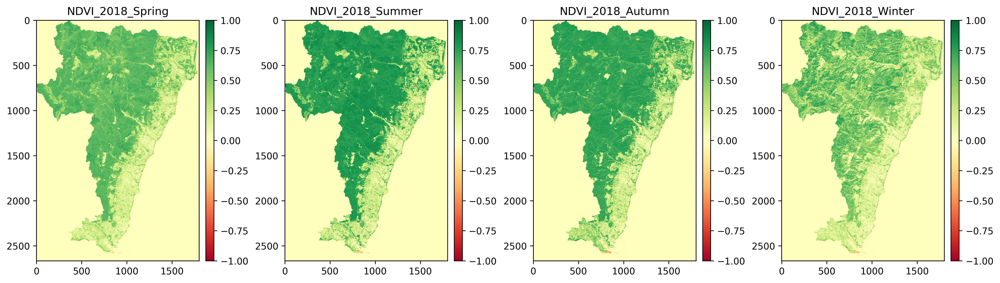

In [ ]:
fig, (ax1, ax2, ax3, ax4)=plt.subplots(1, 4, figsize=(18, 9))
plt.subplots_adjust(wspace=0.4)

NDVI_2018_spring = rio.open(NDVI_DIR + '/sentinel-2_20180420_ndvi.tif')
NDVI_2018_summer = rio.open(NDVI_DIR + '/sentinel-2_20180520_ndvi.tif')
NDVI_2018_autumn = rio.open(NDVI_DIR + '/sentinel-2_20181002_ndvi.tif')
NDVI_2018_winter = rio.open(NDVI_DIR + '/sentinel-2_20181219_ndvi.tif')

NDVI_2018_spring = NDVI_2018_spring.read(1)
NDVI_2018_summer = NDVI_2018_summer.read(1)
NDVI_2018_autumn = NDVI_2018_autumn.read(1)
NDVI_2018_winter = NDVI_2018_winter.read(1)

ndvi1 = ax1.imshow(NDVI_2018_spring, cmap='RdYlGn')
ax1.set_title('NDVI_2018_Spring')
ndvi1.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax1)
ax_cb = divider.new_horizontal(size='5%', pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi1, cax=ax_cb);

ndvi2 = ax2.imshow(NDVI_2018_summer, cmap='RdYlGn')
ax2.set_title('NDVI_2018_Summer')
ndvi2.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax2)
ax_cb = divider.new_horizontal(size='5%', pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi2, cax=ax_cb);

ndvi3 = ax3.imshow(NDVI_2018_autumn, cmap='RdYlGn')
ax3.set_title('NDVI_2018_Autumn')
ndvi3.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax3)
ax_cb = divider.new_horizontal(size='5%', pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi3, cax=ax_cb);

ndvi4 = ax4.imshow(NDVI_2018_winter, cmap='RdYlGn')
ax4.set_title('NDVI_2018_Winter')
ndvi4.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax4)
ax_cb = divider.new_horizontal(size='5%', pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi4, cax=ax_cb);

### 森林地域のNDVIの計算
今回は森林を対象としているので、森林ポリゴンデータを用いて日立市の森林地域のみNDVIを計算する。



In [ ]:

for file_title in ziplst:
  print("Start masking NDVI " +'<'+ file_title +'>')

  path_A = str(file_title) + '.SAFE/GRANULE/'
  f1 = os.listdir(path_A)

  path_B = str(file_title) + '.SAFE/GRANULE/' + str(f1[0])
  f2 = os.listdir(path_B)

  path_C = str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) + '/IMG_DATA/'
  f3 = os.listdir(path_C)

  NDVI_path = os.path.join(NDVI_DIR, 'sentinel-2_'+str(f3[0][7:15])+'_ndvi.tif')

  print("---masking---")

  with fiona.open(out_file_forest, "r") as mask_forest:
    masks_forest = [feature["geometry"] for feature in mask_forest]

  with rio.open(NDVI_path) as src3:
    out_image_ndvi, out_transform = rasterio.mask.mask(src3, masks_forest, crop=True)
    out_meta = src3.meta

  out_meta.update({"driver": "GTiff",
                 "height": out_image_ndvi.shape[1],
                 "width": out_image_ndvi.shape[2],
                 "transform": out_transform})

  NDVI_mask_path = os.path.join(NDVI_mask_DIR, 'sentinel-2_' + str(f3[0][7:15]) + '_ndvi_mask.tif')

  with rio.open(NDVI_mask_path, "w", **out_meta) as dst2:
    dst2.write(out_image_ndvi)

  print("Done")

Start masking NDVI <S2A_MSIL1C_20170508T012701_N0205_R074_T54SVF_20170508T013110>
---masking---
Done
Start masking NDVI <S2A_MSIL1C_20181219T013041_N0207_R074_T54SVF_20181219T031650>
---masking---
Done
Start masking NDVI <S2B_MSIL1C_20181002T011649_N0206_R031_T54SVF_20181002T030308>
---masking---
Done
Start masking NDVI <S2B_MSIL1C_20171027T011719_N0206_R031_T54SVF_20171027T030539>
---masking---
Done
Start masking NDVI <S2B_MSIL1C_20171226T012039_N0206_R031_T54SVF_20171226T024938>
---masking---
Done
Start masking NDVI <S2A_MSIL1C_20180420T011651_N0206_R031_T54SVF_20180420T030851>
---masking---
Done
Start masking NDVI <S2A_MSIL1C_20180520T011701_N0206_R031_T54SVF_20180520T030828>
---masking---
Done


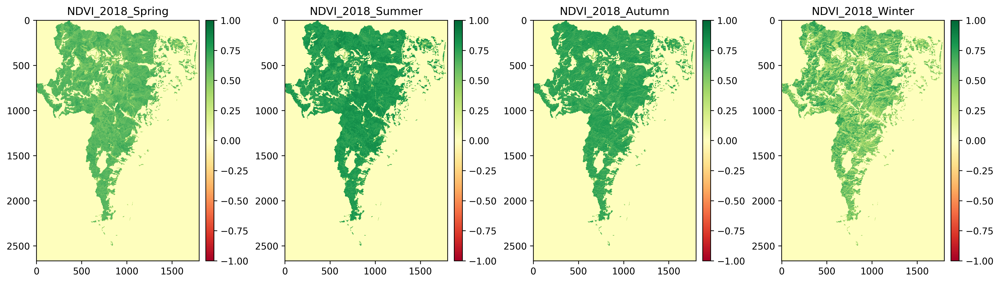

In [ ]:
fig, (ax1, ax2, ax3, ax4)=plt.subplots(1, 4, figsize=(18, 9))
plt.subplots_adjust(wspace=0.4)

NDVI_2018_spring = rio.open(NDVI_mask_DIR + '/sentinel-2_20180420_ndvi_mask.tif')
NDVI_2018_summer = rio.open(NDVI_mask_DIR + '/sentinel-2_20180520_ndvi_mask.tif')
NDVI_2018_autumn = rio.open(NDVI_mask_DIR + '/sentinel-2_20181002_ndvi_mask.tif')
NDVI_2018_winter = rio.open(NDVI_mask_DIR + '/sentinel-2_20181219_ndvi_mask.tif')

NDVI_2018_spring = NDVI_2018_spring.read(1)
NDVI_2018_summer = NDVI_2018_summer.read(1)
NDVI_2018_autumn = NDVI_2018_autumn.read(1)
NDVI_2018_winter = NDVI_2018_winter.read(1)

ndvi1 = ax1.imshow(NDVI_2018_spring, cmap='RdYlGn')
ax1.set_title('NDVI_2018_Spring')
ndvi1.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax1)
ax_cb = divider.new_horizontal(size='5%', pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi1, cax=ax_cb);

ndvi2 = ax2.imshow(NDVI_2018_summer, cmap='RdYlGn')
ax2.set_title('NDVI_2018_Summer')
ndvi2.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax2)
ax_cb = divider.new_horizontal(size='5%', pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi2, cax=ax_cb);

ndvi3 = ax3.imshow(NDVI_2018_autumn, cmap='RdYlGn')
ax3.set_title('NDVI_2018_Autumn')
ndvi3.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax3)
ax_cb = divider.new_horizontal(size='5%', pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi3, cax=ax_cb);

ndvi4 = ax4.imshow(NDVI_2018_winter, cmap='RdYlGn')
ax4.set_title('NDVI_2018_Winter')
ndvi4.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax4)
ax_cb = divider.new_horizontal(size='5%', pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi4, cax=ax_cb);

### 森林状態変化のグラフ表示
作成したNDVI画像を用いて森林地域の変化を推定し、可視化する。
今回はポリゴンによって抜き出した範囲を森林地域として、範囲内のNDVI変化を見ることで森林の状態変化を推定する。

はじめに森林地域のNDVI値を集計して平均値、最大値、最小値を算出する。

In [ ]:
# NDVI値の集計
NDVI_list = os.listdir(NDVI_mask_DIR)

NDVI_files = []
ind = []
col = []
NDVI_max=[]
NDVI_min=[]
value_ave=[]

#for seane in sorted(NDVI_list):
#  if "2018" in seane:
#    NDVI_files.append(seane)

for seane in sorted(NDVI_list):
   NDVI_files.append(seane)

for seane in sorted(NDVI_files):
  print("Start " +'<'+ seane +'>')
  NDVI_image = rio.open(NDVI_mask_DIR +"/"+ seane)
  NDVI_image_2 = NDVI_image.read()
  ind.append('NDVI_forest' + '_' + str(seane[11:19]))
  col.append('NDVI_' + str(seane[15:22]))
  NDVI_max.append(np.max(NDVI_image_2))
  NDVI_min.append(np.min(NDVI_image_2))
  NDVI_value = NDVI_image_2[np.nonzero(NDVI_image_2)].mean()
  value_ave.append(NDVI_value)
  print("done")

Start <sentinel-2_20170508_ndvi_mask.tif>
done
Start <sentinel-2_20171027_ndvi_mask.tif>
done
Start <sentinel-2_20171226_ndvi_mask.tif>
done
Start <sentinel-2_20180420_ndvi_mask.tif>
done
Start <sentinel-2_20180520_ndvi_mask.tif>
done
Start <sentinel-2_20181002_ndvi_mask.tif>
done
Start <sentinel-2_20181219_ndvi_mask.tif>
done


計算した結果を用いて、各時期のNDVI平均値を正規化する。
7時期の中で、NDVIの値が最も高いと考えられる5月のNDVI平均値を全体の最大値とし、最も低いと考えられる12月のNDVI平均値を全体の最小値とする。

In [ ]:
NDVI_normalized = []

for va in value_ave:
  nor = ((va - NDVI_min[3]) / (NDVI_max[1] - NDVI_min[3]))
  NDVI_normalized.append(nor)

print('Done')

Done


正規化した値の中で、植生が最も活性化する夏季（今回は5月）の正規化NDVI平均値を基準に日立市における森林面積に対し、各季節と夏季の比率を積算することで、季節変化における森林の状態推移を推定する。

日立市における森林面積は森林域をマスクする際に使用した国土数値情報および農林水産省のデータを参照し12,065haとする。

（参照元： 　2020年12月時点）


In [ ]:
forest_area = 12065

forest = []

for seasonal_data in NDVI_normalized:
  est_fore = forest_area + (seasonal_data/NDVI_normalized[1])
  forest.append(est_fore)

print('Done')

Done


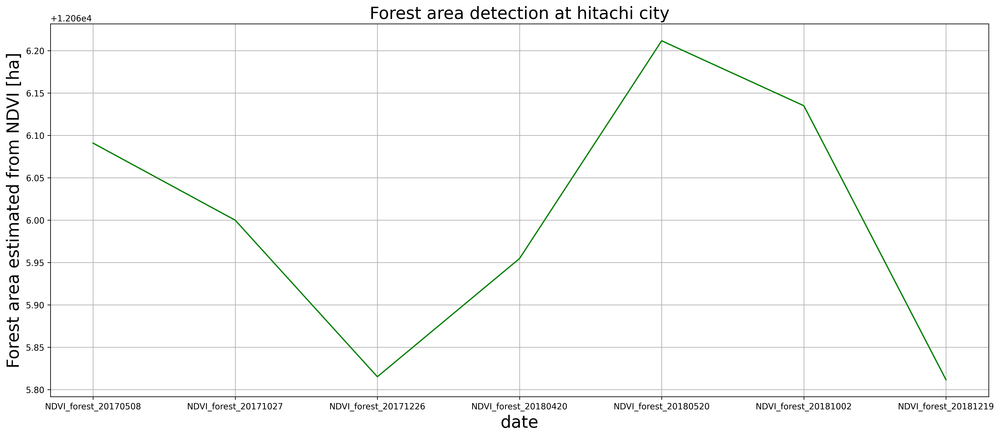

In [ ]:
fig,ax1 = plt.subplots(1,1,figsize=(20,8))
ax1.plot(ind,forest,color="green")
ax1.set_xlabel("date",fontsize=20)
ax1.set_ylabel("Forest area estimated from NDVI [ha]",fontsize=20)
ax1.grid(True)
plt.title("Forest area detection at hitachi city",fontsize=20)
fig.show();

日立市の森林は2017年の5月から12月にかけて減少し、4月から5月に向けて繁茂している森林の面積が増加している。その後、2018年の5月から10月にかけて減少し、12月にはさらに落ち込んでいる。

樹木は主に常緑樹と落葉樹の2つに分類できますが、NDVIは葉の活性度と相関性があるため、12月の減少は落葉による影響と考えられる。このことから、日立市の森林は落葉樹が多いと考えられる。

5月のデータは2018年の方が数値が高いが、2017年は5月8日、2018年は5月20日のデータである。仮に、2017年の5月下旬のデータが撮れていれば、2018年と同様の数値になったのではないかと考えられる。また、天候の違いによって生長の時期に差が生じている可能性もある。

次に2017年と2018年の5月のNDVI画像を比較してみる。

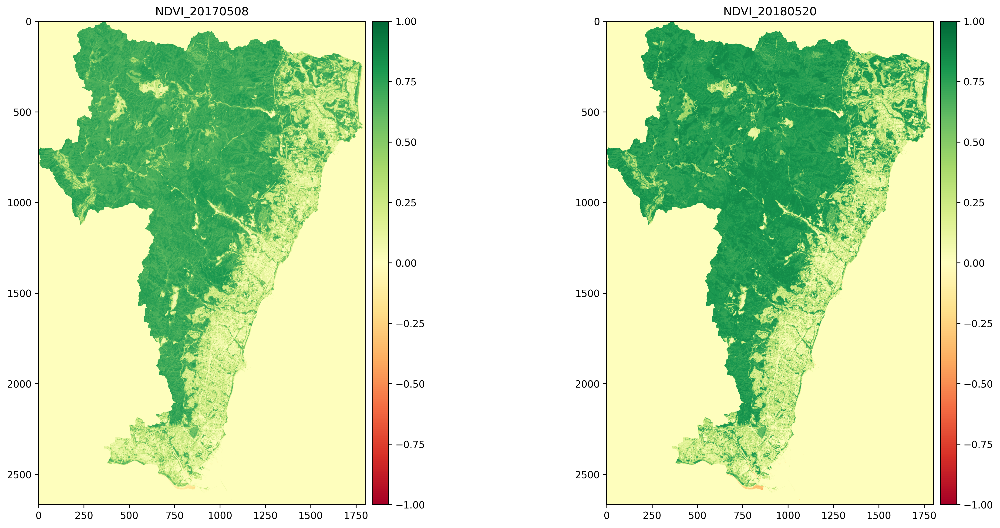

In [ ]:
fig,(ax1,ax2)=plt.subplots(1,2, figsize=(18,9))
plt.subplots_adjust(wspace=0.4)

NDVI_2017 = rio.open(NDVI_DIR+'/sentinel-2_20170508_ndvi.tif')
NDVI_2018 = rio.open(NDVI_DIR+'/sentinel-2_20180520_ndvi.tif')


NDVI_2017 = NDVI_2017.read(1)
NDVI_2018 = NDVI_2018.read(1)

ndvi1=ax1.imshow(NDVI_2017, cmap='RdYlGn')
ax1.set_title("NDVI_20170508")
ndvi1.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax1)
ax_cb = divider.new_horizontal(size="5%", pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi1, cax=ax_cb);

ndvi2=ax2.imshow(NDVI_2018, cmap='RdYlGn')
ax2.set_title("NDVI_20180520")
ndvi2.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax2)
ax_cb = divider.new_horizontal(size="5%", pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi2, cax=ax_cb);

画像の上側中央付近においてNDVI値が落ち込んでいる地点が見受けられる。

二時期のNDVIの差分を取り、切り出してみる。またカラー合成画像から同様の範囲を切り出して、NDVIの差分画像と比較してみる。

In [ ]:
#範囲の指定
minX = 750
minY = 400
deltaX = 300
deltaY = 300

#NDVI差分の作成
NDVI_2017 = rio.open(NDVI_DIR+'/sentinel-2_20170508_ndvi.tif')
NDVI_2018 = rio.open(NDVI_DIR+'/sentinel-2_20180520_ndvi.tif')

ndvi_2017 = NDVI_2017.read()
ndvi_2018 = NDVI_2018.read()

ndvi_diff = np.where(((ndvi_2017 != 0) & (ndvi_2018 != 0)),(ndvi_2018.astype(float)-ndvi_2017.astype(float)), 0)

out_meta = NDVI_2017.meta
out_meta.update(driver='GTiff')
out_meta.update(dtype=rio.float32)

NDVI_diff_path = os.path.join(NDVI_DIR,'sentinel-2_ndvi_diff.tif')

with rio.open(NDVI_diff_path, 'w', **out_meta) as dst:
  dst.write(ndvi_diff.astype(rio.float32))

path_ndvi_diff = "/content/NDVI/sentinel-2_ndvi_diff.tif"

#NDVI差分画像の切り出し
print("Start cliping images " +'<'+ str(path_ndvi_diff) +'>')
maskdata_path = os.path.join(NDVI_DIR + "/" + "ndvi_diff_clip.tif")
ds=gdal.Translate(maskdata_path, path_ndvi_diff, srcWin=[minX,minY,deltaX,deltaY])

#RGB画像の指定
path_2017 = "/content/RGB_TIF/sentinel-2_20170508.tif"
path_2018 = "/content/RGB_TIF/sentinel-2_20180520.tif"

ln = [path_2017,path_2018]

#切り出し
for n in ln:
  print("Start cliping images " +'<'+ n +'>')
  maskdata_path = os.path.join(RGB_DIR + "/" + "clip_" + str(n[28:32]) + ".tif")
  ds=gdal.Translate(maskdata_path, n, srcWin=[minX,minY,deltaX,deltaY])
  ds=None

Start cliping images </content/NDVI/sentinel-2_ndvi_diff.tif>
Start cliping images </content/RGB_TIF/sentinel-2_20170508.tif>
Start cliping images </content/RGB_TIF/sentinel-2_20180520.tif>


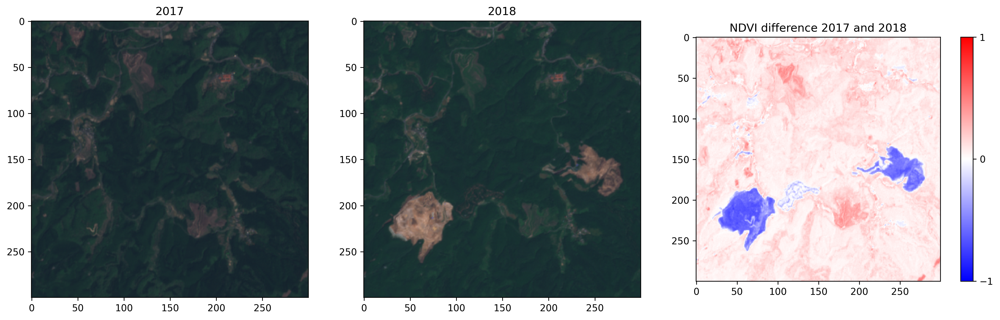

In [ ]:
fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(18,18))

#画像の読み込み
cut_img2017=rio.open("/content/RGB_TIF/clip_2017.tif")
cut_img2018=rio.open("/content/RGB_TIF/clip_2018.tif")
cut_imgNDVI=rio.open("/content/NDVI/ndvi_diff_clip.tif")

ax1 = plt.subplot(1,3,1)
ax1.set_title("2017")
ax2 = plt.subplot(1,3,2)
ax2.set_title("2018")
ax3 = plt.subplot(1,3,3)
ax3.set_title("NDVI difference 2017 and 2018")

show(cut_img2017.read([1,2,3]),ax=ax1)
show(cut_img2018.read([1,2,3]),ax=ax2)

img_n = ax3.imshow(cut_imgNDVI.read(1), cmap=plt.cm.bwr)
img_n.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax3)
cax = divider.append_axes("right",size="5%", pad=0.3)
cbar = plt.colorbar(img_n, cax=cax,ticks=[-1, 0, 1])

上の図は左から、2017年のカラー合成画像、2018年のカラー合成画像、2017年と2018年のNDVIの差分画像となっている。NDVI差分画像の範囲は-1から1をとっており、差分の値が1に近い（赤色が強い）ほど植物が増えていることを示しており、-1に近い（青色が強い）ほど植生が減少していることを示している。

差分画像とカラー合成画像を見比べてみると、青色が強調されている地域では、森林と思われる地域が裸地に変化していると見受けられる。 赤色が強調されている地域は、もともと裸地であった地域に植生が繁茂しているといえる。これは落葉樹の展葉等に伴い、一時的に変化として表れていることが考えられる。 そのため、経年変化で比較する際にも、取得する衛星の観測時期を考慮する必要があるといえる。

青色が強調されている地域の様子をGoogle Earthで見てみると、ソーラーパネルによる発電施設が建設されていることがわかる。

Googleマップ(衛星画像)
2023年10月19日時点閲覧
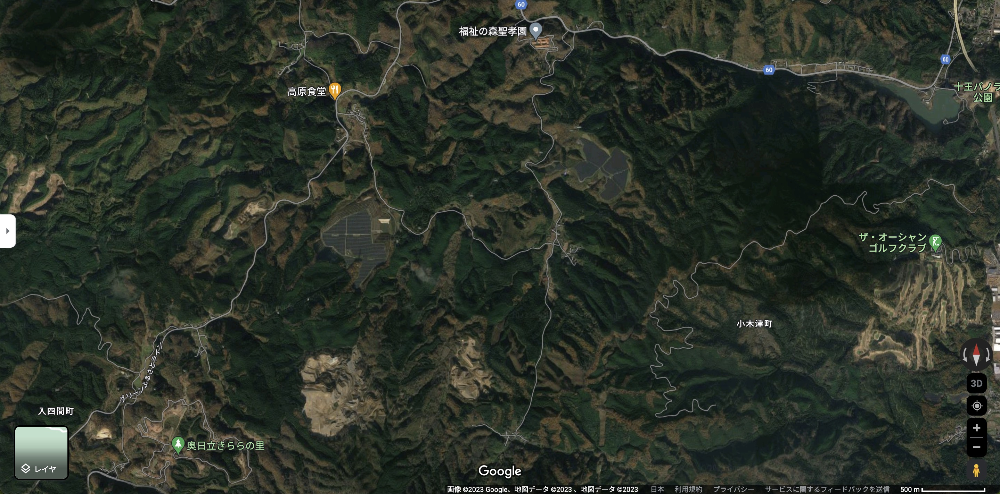